# Introduction to Python  

## Network Science and Graph Analysis

#### Network science is an academic field which studies complex networks such as telecommunication networks, computer networks, biological networks, cognitive and semantic networks, and social networks, considering distinct elements or actors represented by nodes (or vertices) and the connections between the elements or actors as links (or edges). The field draws on theories and methods including graph theory from mathematics, statistical mechanics from physics, data mining and information visualization from computer science, inferential modeling from statistics, and social structure from sociology. (from wikipedia)

[Barabási Book](http://networksciencebook.com/)   
[NetworkX Library](https://networkx.org/)  
[PageRank Algorithm](https://en.wikipedia.org/wiki/PageRank)

[Bug article](https://stackoverflow.com/questions/70508775/error-could-not-build-wheels-for-pycairo-which-is-required-to-install-pyprojec) 

##### Installing libraries  

In [1]:
#!sudo apt-get install libcairo2-dev libjpeg-dev libgif-dev graphviz SPARQLWrapper
#!pip install -U pydot xlrd datashader holoviews pycairo cairocffi beautifulsoup4 networkx 
#!pip install -U scikit-image python-igraph lxml pygraphviz manimlib
#!pip install -U manimce

In [2]:
import os
import operator
import codecs
import random
import math
from itertools import chain

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pylab as pl
import pandas as pd
from collections import Counter, OrderedDict
import urllib
from bs4 import BeautifulSoup
import pydot

from IPython.display import display, Image
from IPython.core.interactiveshell import InteractiveShell

%matplotlib inline

## Python Graph Libraries

### [Networkx](https://networkx.org/)

In [3]:
import networkx as nx
from networkx import Graph as NXGraph
from networkx.drawing.nx_agraph import graphviz_layout

In [4]:
df = pd.read_excel('../../Data/xls/WG_Ontology.xls')
df.loc[0,'Superclass(es)'] = 'owl:Thing'
df.head(30)

,Entity,Type,Superclass(es),based_near,knows,member,topic_interest,hasProject
0,Group,Class,owl:Thing,NaN,NaN,NaN,NaN,NaN
1,Organization,Class,Agent,NaN,NaN,NaN,NaN,NaN
2,Person,Class,Agent,NaN,NaN,NaN,NaN,NaN
3,Data_Science,Class,Computer_and_Information_Science,NaN,NaN,NaN,NaN,NaN
4,Knowledge_Organization_Systems,Class,Computer_and_Information_Science,NaN,NaN,NaN,NaN,NaN
5,Network_Analysis,Class,Computer_and_Information_Science,NaN,NaN,NaN,NaN,NaN
6,Semantic_Web,Class,Computer_and_Information_Science,NaN,NaN,NaN,NaN,NaN
7,Machine_Learning,Class,Data_Science,NaN,NaN,NaN,NaN,NaN
8,Natural_Language_Processing,Class,Data_Science,NaN,NaN,NaN,NaN,NaN
9,WG1,Class,Group,NaN,NaN,DKU,NaN,NaN


In [5]:
#possible colors' names
mcolors.cnames.keys()

dict_keys(['aliceblue', 'antiquewhite', 'aqua', 'aquamarine', 'azure', 'beige', 'bisque', 'black', 'blanchedalmond', 'blue', 'blueviolet', 'brown', 'burlywood', 'cadetblue', 'chartreuse', 'chocolate', 'coral', 'cornflowerblue', 'cornsilk', 'crimson', 'cyan', 'darkblue', 'darkcyan', 'darkgoldenrod', 'darkgray', 'darkgreen', 'darkgrey', 'darkkhaki', 'darkmagenta', 'darkolivegreen', 'darkorange', 'darkorchid', 'darkred', 'darksalmon', 'darkseagreen', 'darkslateblue', 'darkslategray', 'darkslategrey', 'darkturquoise', 'darkviolet', 'deeppink', 'deepskyblue', 'dimgray', 'dimgrey', 'dodgerblue', 'firebrick', 'floralwhite', 'forestgreen', 'fuchsia', 'gainsboro', 'ghostwhite', 'gold', 'goldenrod', 'gray', 'green', 'greenyellow', 'grey', 'honeydew', 'hotpink', 'indianred', 'indigo', 'ivory', 'khaki', 'lavender', 'lavenderblush', 'lawngreen', 'lemonchiffon', 'lightblue', 'lightcoral', 'lightcyan', 'lightgoldenrodyellow', 'lightgray', 'lightgreen', 'lightgrey', 'lightpink', 'lightsalmon', 'lights

In [6]:
## number of classes
len(df['Superclass(es)'].unique())

15

In [7]:
## one color for each class

chosen = ['aliceblue', 
          'antiquewhite',
          'aquamarine', 
          'azure', 
          'beige', 
          'bisque', 
          'pink', 
          'blanchedalmond', 
          'lightskyblue', 
          'lightcoral', 
          'brown', 
          'burlywood',
          'cadetblue', 
          'coral', 
          'cornflowerblue']

colors = dict(zip(df['Superclass(es)'].unique(),chosen))
df_colors = pd.DataFrame({'classes':df['Superclass(es)'].unique(), 'colors':chosen})
df_colors.head(15)

,classes,colors
0,owl:Thing,aliceblue
1,Agent,antiquewhite
2,Computer_and_Information_Science,aquamarine
3,Data_Science,azure
4,Group,beige
5,History,bisque
6,Languages,pink
7,Linguistics,blanchedalmond
8,Location,lightskyblue
9,Natural_Language_Processing,lightcoral


In [8]:
#create graph
G = nx.DiGraph()

#add nodes
for idx in df.index:
    G.add_node(df.loc[idx,'Entity'], color=colors[df.loc[idx,'Superclass(es)']])
    
#add edges class-subclass    
G.add_edges_from(zip(df['Entity'].values, df['Superclass(es)'].values),
                 color='turquoise',
                 relation = 'is a')

#add edges 'based near'
df2 = df.dropna(axis=0, subset=['based_near'])
for idx in df2.index:
    for base in df2.loc[idx,'based_near'].split(','):
        G.add_edge(df2.loc[idx,'Entity'], base,
                   color='violet', 
                   relation='based near')

#add edges 'member'
df2 = df.dropna(axis=0, subset=['member'])
for idx in df2.index:
    for member in df2.loc[idx,'member'].split(','):
        G.add_edge(df2.loc[idx,'Entity'], member,
                   color='peachpuff', 
                   relation='member')
        
#add edges 'topic_interest'
df2 = df.dropna(axis=0, subset=['topic_interest'])
for idx in df2.index:
    for topic in df2.loc[idx,'topic_interest'].split(','):
        G.add_edge(df2.loc[idx,'Entity'], topic,
                   color='steelblue', 
                   relation='topic_interest')

#add edges 'hasProject'
df2 = df.dropna(axis=0, subset=['hasProject'])
for idx in df2.index:
    for project in df2.loc[idx,'hasProject'].split(','):
        G.add_edge(df2.loc[idx,'Entity'], project,
                   color='plum', 
                   relation='hasProject')

In [9]:
#G.nodes(data=True)
#G.edges(data=True)

In [10]:
G

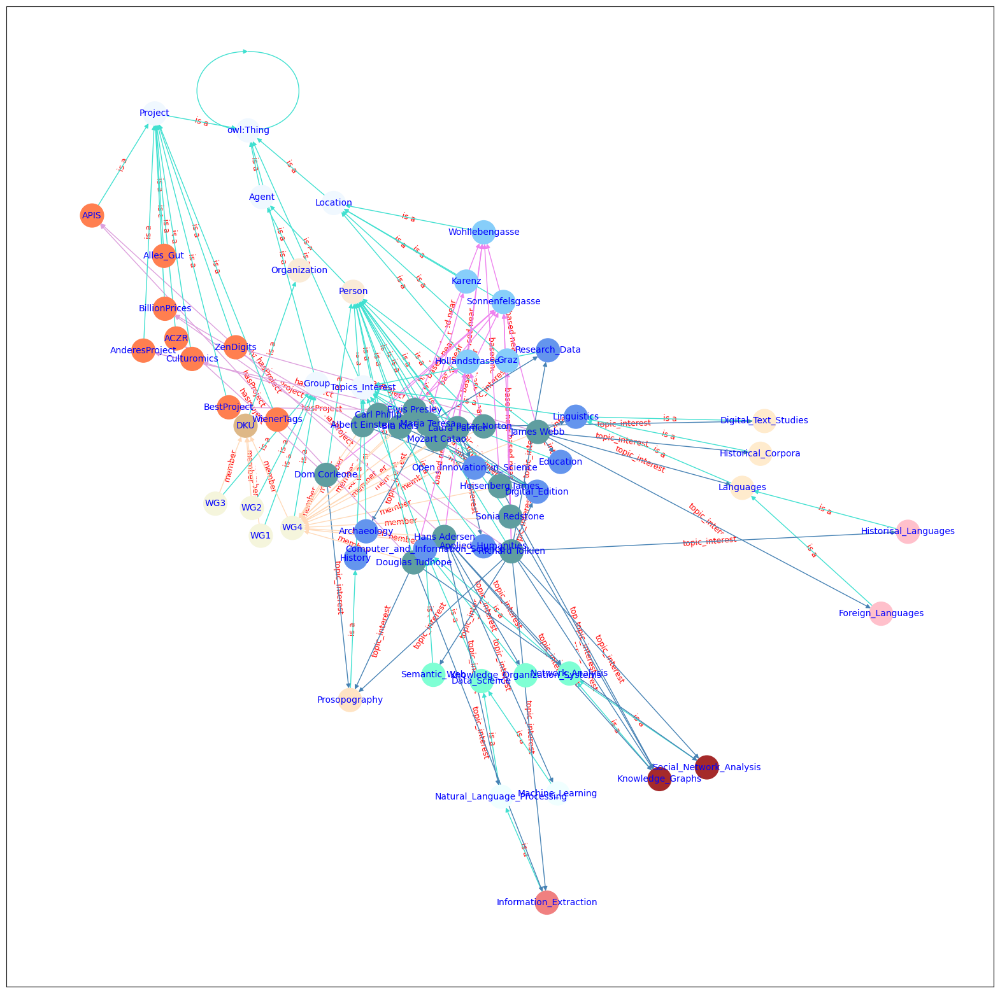

In [11]:
#plt.figure(figsize=(20,20))
fig, ax = plt.subplots(figsize=(20,20))

#pos = graphviz_layout(G, prog='neato', args='') ## https://stackoverflow.com/questions/21978487/improving-python-networkx-graph-layout
pos = nx.spring_layout(G, scale=1)

## https://networkx.github.io/documentation/stable/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html
nx.draw_networkx_edge_labels(G, 
                             pos, 
                             edge_labels=nx.get_edge_attributes(G,'relation'),
                             label_pos=0.5, 
                             font_size=9, 
                             font_color='red', 
                             font_family='sans-serif', 
                             font_weight='normal', 
                             alpha=1.0, 
                             bbox=None, 
                             ax=ax, 
                             rotate=True,)

nx.draw_networkx(G, 
                 pos=pos, 
                 arrows=True,
                 with_labels=True,
                 ax=ax,
                 nodelist=G.nodes(),
                 edgelist=G.edges(),
                 node_size=700,
                 node_color=[nx.get_node_attributes(G,'color')[g] for g in G.nodes()],
                 node_shape='o',
                 alpha=1.0,
                 cmap=None,
                 vmin=None,
                 vmax=None,
                 linewidths=1.0,
                 width=1.0,
                 edge_color=[nx.get_edge_attributes(G,'color')[g] for g in G.edges()],
                 edge_cmap=None,
                 edge_vmin=None,
                 edge_vmax=None,
                 style='solid',
                 labels=None ,
                 font_size=10,
                 font_color='blue',
                 font_weight='normal',
                 font_family='sans-serif',
                 label='ACDH-CH WG4 Graph',)


## https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.savefig.html
#plt.savefig("../Data/Figs/my_Graph.jpg", format="jpg", dpi=100)
plt.show()

### [Data Shader](https://datashader.org/index.html) - [networks](https://datashader.org/user_guide/Networks.html)

Datashader offers different ways to visualize specific types of data. For instance, network graph data. 
It can very naturally be represented by points and lines.  
Here we will show examples of using Datashader's graph-specific plotting tools, focusing on how to visualize very large graphs while allowing any portion of the rendering pipeline to replaced with components suitable for specific problems.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
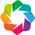

In [12]:
import datashader as ds
import datashader.transfer_functions as tf
from datashader.layout import random_layout, circular_layout, forceatlas2_layout
from datashader.bundling import connect_edges, hammer_bundle
import holoviews.operation.datashader as hd
import holoviews as hv
hv.extension("bokeh")

### Graph (node) layout

Some graph data is inherently spatial, such as connections between geographic locations, and these graphs can simply be plotted by connecting each location with line segments. However, most graphs are more abstract, with nodes having no natural position in space, and so they require a "layout" operation to choose a 2D location for each node before the graph can be visualized.  Unfortunately, choosing such locations is an [open-ended problem involving a complex set of tradeoffs and complications](http://www.hiveplot.com).

Datashader provides a few tools for doing graph layout, while also working with external layout tools. As a first example, let's generate a random graph, with 100 points normally distributed around the origin and 20000 random connections between them:

In [13]:
np.random.seed(0)
n = 100
m = 20000

nodes = pd.DataFrame(["node" + str(i) for i in range(n)], columns=['name'])
nodes.tail()

,name
95,node95
96,node96
97,node97
98,node98
99,node99


In [14]:
edges = pd.DataFrame(np.random.randint(0,len(nodes), size=(m, 2)), columns=['source', 'target'])
edges.tail()

,source,target
19995,95,22
19996,16,17
19997,10,17
19998,61,69
19999,56,23


To make this abstract graph plottable, we'll need to choose an x,y location for each node. There are two simple and fast layout algorithms included:

In [15]:
circular = circular_layout(nodes, uniform=False)
circular.tail()

,name,x,y
95,node95,0.650484,0.976817
96,node96,0.692706,0.038627
97,node97,0.715375,0.951236
98,node98,0.807387,0.105648
99,node99,0.751535,0.067877


In [16]:
randomloc = random_layout(nodes)
randomloc.tail()

,name,x,y
95,node95,0.017333,0.339912
96,node96,0.316948,0.945550
97,node97,0.922087,0.377254
98,node98,0.088389,0.625179
99,node99,0.869591,0.194674


Random layout,Circular layout

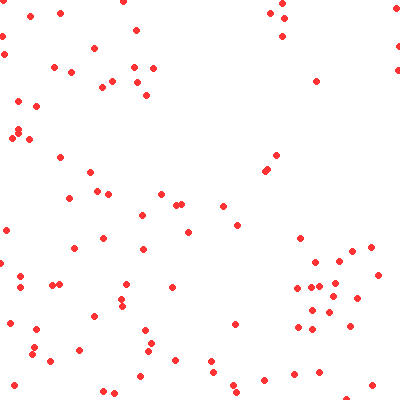
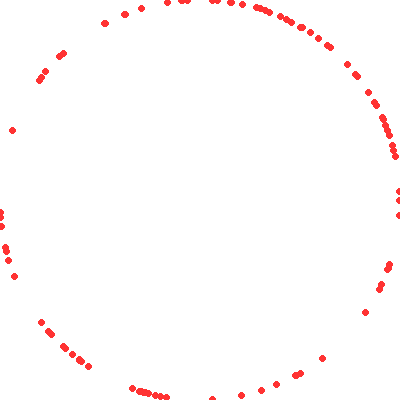

In [17]:
cvsopts = dict(plot_height=400, plot_width=400)

def nodesplot(nodes, name=None, canvas=None, cat=None):
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    aggregator=None if cat is None else ds.count_cat(cat)
    agg=canvas.points(nodes,'x','y',aggregator)
    return tf.spread(tf.shade(agg, cmap=["#FF3333"]), px=3, name=name)

tf.Images(nodesplot(randomloc,"Random layout"),
          nodesplot(circular, "Circular layout"))

The circular layout provides an option to distribute the nodes randomly along the circle or evenly, and here we've chosen the former.

The two layouts above ignore the connectivity structure of the graph, focusing only on the nodes.  
The [ForceAtlas2](http://journals.plos.org/plosone/article/file?id=10.1371/journal.pone.0098679&type=printable) algorithm is a more complex approach that treats connections like physical forces (a force-directed approach) in order to construct a layout for the nodes based on the network connectivity:

ForceAtlas2 layout

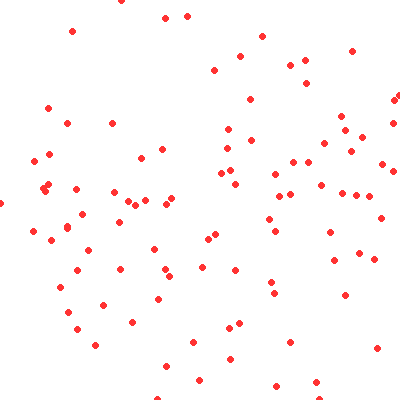

In [18]:
forcedirected = forceatlas2_layout(nodes, edges)
tf.Images(nodesplot(forcedirected, "ForceAtlas2 layout"))

This algorithm is designed to place densely connected nodes closer to each other, but of course we will only be able to evaluate how well it has done so once we plot edges (below).

#### Edge rendering/bundling

Assuming that we have a suitable layout for the nodes, we can now plot the connections between them.  There are currently two bundling algorithms provided: drawing a line directly between any connected nodes (``connect_edges``), and an iterative "bundling" algorithm ``hammer_bundle`` (a variant of [Hurter, Ersoy, & Telea, ECV-2012](http://www.cs.rug.nl/svcg/Shapes/KDEEB)) that allows edges to curve and then groups nearby ones together to help convey structure. Rendering direct connections should be very quick, even for large graphs, but bundling can be quite computationally intensive.

In [19]:
def edgesplot(edges, name=None, canvas=None):
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    return tf.shade(canvas.line(edges, 'x','y', agg=ds.count()), name=name)
    
def graphplot(nodes, edges, name="", canvas=None, cat=None):
    if canvas is None:
        xr = nodes.x.min(), nodes.x.max()
        yr = nodes.y.min(), nodes.y.max()
        canvas = ds.Canvas(x_range=xr, y_range=yr, **cvsopts)
        
    np = nodesplot(nodes, name + " nodes", canvas, cat)
    ep = edgesplot(edges, name + " edges", canvas)
    return tf.stack(ep, np, how="over", name=name)

Circular layout,Force-directed
"Circular layout, bundled","Force-directed, bundled"

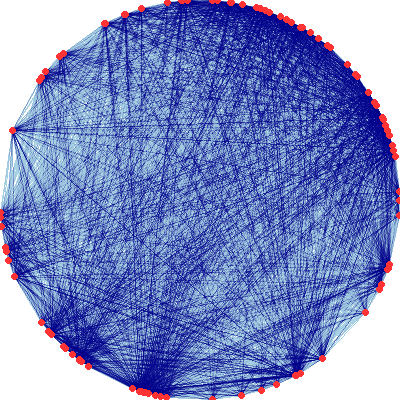
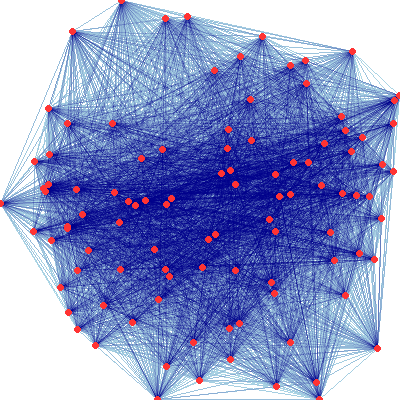
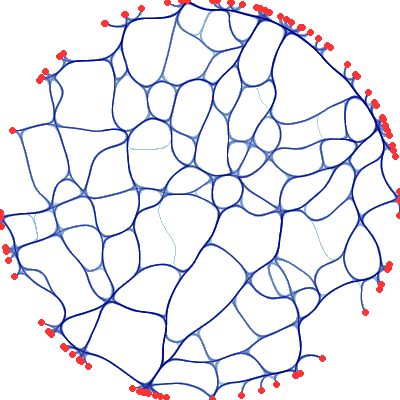
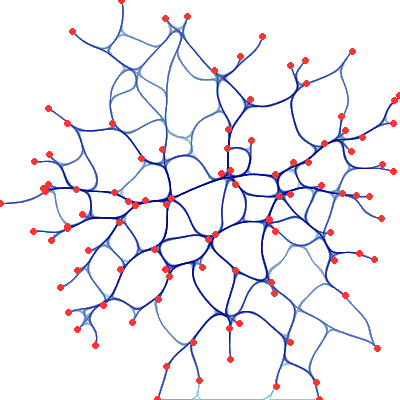

In [20]:
cd = circular
fd = forcedirected

cd_d = graphplot(cd, connect_edges(cd,edges), "Circular layout")
fd_d = graphplot(fd, connect_edges(fd,edges), "Force-directed") 
cd_b = graphplot(cd, hammer_bundle(cd,edges), "Circular layout, bundled")
fd_b = graphplot(fd, hammer_bundle(fd,edges), "Force-directed, bundled") 

tf.Images(cd_d,fd_d,cd_b,fd_b).cols(2)

The four examples above plot the same network structure by either connecting the nodes directly with lines or bundling the connections, and by using a random layout or a force-directed layout.  As you can see, these options have a big effect on the resulting visualization. 

Here we'll look more closely at the bundling algorithm, using a simple example where we know the structure: a single node at the center, with random points on a circle around it that connect to the central node (a star graph topology):

<!-- def circle(r,n): return [(math.cos(2*math.pi/n*x)*r,math.sin(2*math.pi/n*x)*r) for x in range(0,n)] -->

In [21]:
n = 75
np.random.seed(0)
x = np.random.random(n)

snodes = pd.DataFrame(np.stack((np.cos(2*math.pi*x),
                               np.sin(2*math.pi*x))).T, columns=['x','y'])
snodes.iloc[0] = (0.0,0.0)
sedges = pd.DataFrame(list(zip((range(1,n)),[0]*n)),columns=['source', 'target'])
star = snodes,sedges

Star,Star bundled

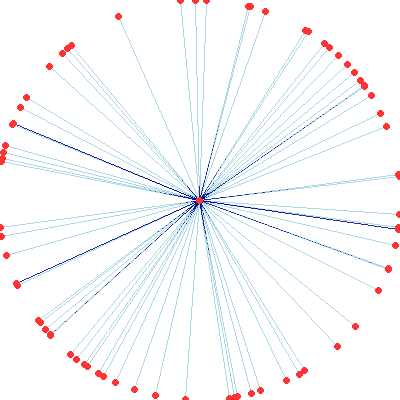
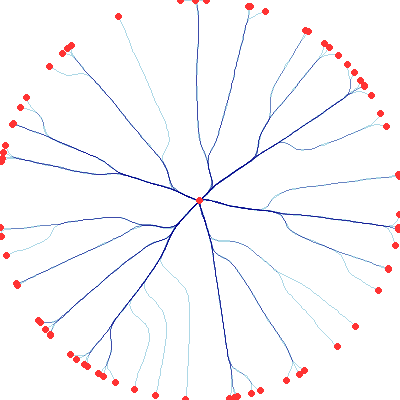

In [22]:
tf.Images(graphplot(snodes, connect_edges(*star),"Star"),
          graphplot(snodes, hammer_bundle(*star),"Star bundled"))

Here you can see the bundling algorithm forms groups of nearby connnections, which helps make the structure at a particular scale clear.  The scale of this structure, i.e., how much bundling is done, is determined by an effective "bandwidth", which is a combination of an `initial_bandwidth` parameter and a `decay` time constant for annealing this bandwidth over time:

In [23]:
grid =  [graphplot(snodes, 
                   hammer_bundle(*star, 
                                 iterations=5, 
                                 decay=decay, 
                                 initial_bandwidth=bw), 
                   "d={:0.2f}, bw={:0.2f}".format(decay, bw)) for decay in [0.1, 0.25, 0.5, 0.9] for bw in [0.1, 0.2, 0.5, 1]]

"d=0.10, bw=0.10","d=0.10, bw=0.20","d=0.10, bw=0.50","d=0.10, bw=1.00"
"d=0.25, bw=0.10","d=0.25, bw=0.20","d=0.25, bw=0.50","d=0.25, bw=1.00"
"d=0.50, bw=0.10","d=0.50, bw=0.20","d=0.50, bw=0.50","d=0.50, bw=1.00"
"d=0.90, bw=0.10","d=0.90, bw=0.20","d=0.90, bw=0.50","d=0.90, bw=1.00"

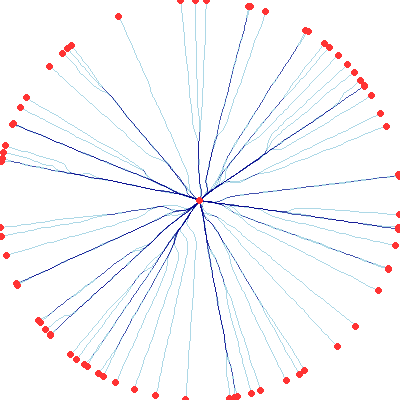
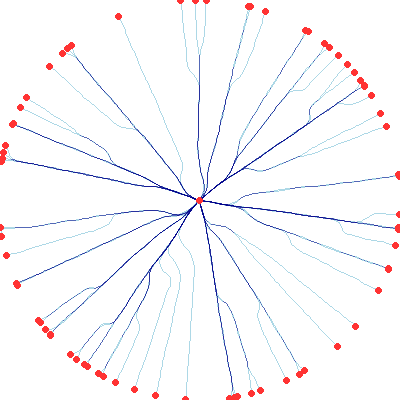
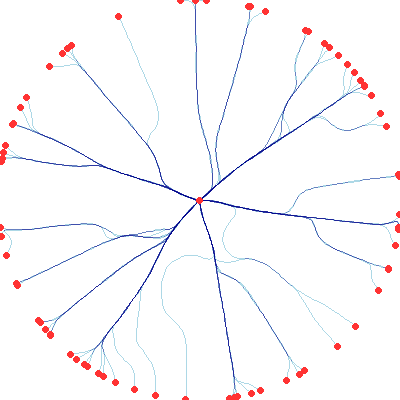
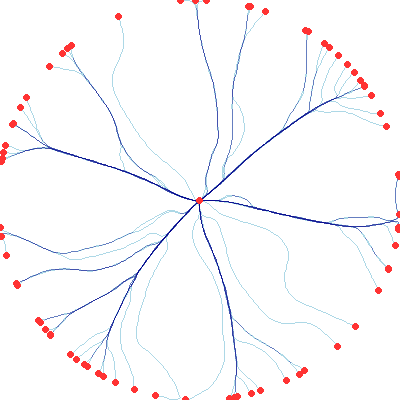
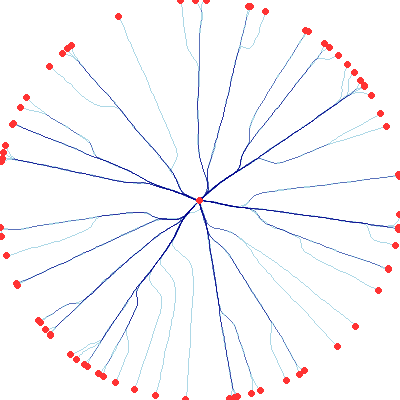
...
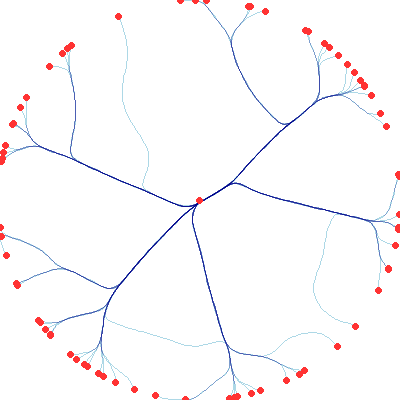
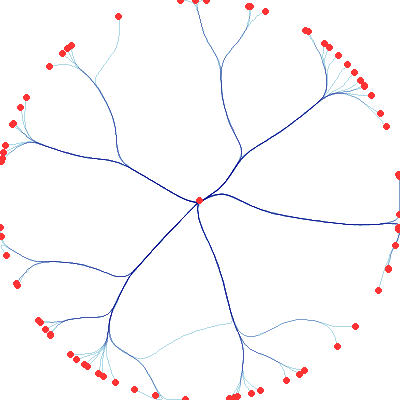
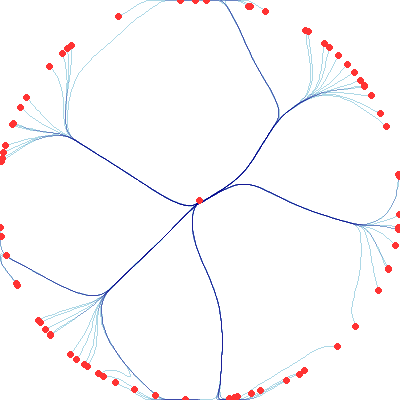
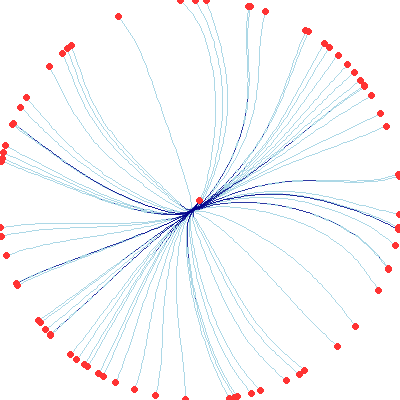
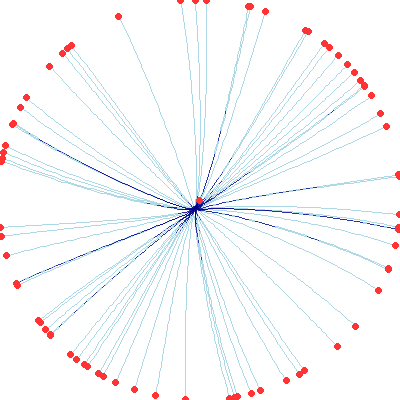

In [24]:
tf.Images(*grid).cols(4)

Starting from the bottom left and moving diagonally to the upper right, the scale of the bundling increases along a diagonal to the upper right, with higher initial bandwidth and higher decay time constants leading to larger-scale bundling.  For the largest decay time constant, the algorithm has failed to converge for large initial bandwidths (the bw 0.5 and 1.0 plots on the bottom row), because the algorithm stops at a specified maximum `iterations`, rather than reaching a fully organized state.

Of course, even when the algorithm does converge, larger amounts of bundling can magnify small amounts of clumping over large scales, which may or may not be relevant to the questions being asked of this data, so it is important to set these parameters appropriately for the types of structures of interest.

<!--
max_iterations=10
hmap = hv.HoloMap({(it, bw, decay): hv.Curve(hammer_bundle(nodes.data, edges.data,
                         decay=decay, initial_bandwidth=bw, iterations=it))
                     for decay in [0.1, 0.25, 0.5, 1, 2] 
                     for bw in [0.1, 0.2, 0.5, 1] 
                     for it in range(max_iterations)},
                   kdims=['Iteration', 'Initial bandwidth', 'Decay'])
    
nodes_ds = datashade(nodes,cmap=["cyan"])
datashade(hmap.grid(['Initial bandwidth', 'Decay']), **sz).map(lambda e_ds: e_ds * nodes, hv.DynamicMap)
-->

### Graphs with categories

One of the main uses for visualizations of large graphs is to examine the connectivity patterns from nodes of different categories. Let's consider an artificial example with four groups of highly interconnected nodes:

In [25]:
np.random.seed(1)
cats,n,m = 4,80,1000

cnodes = pd.concat([pd.DataFrame.from_records([("node"+str(i+100*c),"c"+str(c)) for i in range(n)], 
                                              columns=['name','cat']) for c in range(cats)], ignore_index=True)
cnodes.cat = cnodes.cat.astype('category')

cedges = pd.concat([pd.DataFrame(np.random.randint(n*c,n*(c+1), size=(m, 2)), 
                                 columns=['source', 'target']) for c in range(cats)], ignore_index=True)

The ``cnodes`` and ``cedges`` data structures form a graph that has clear structure not visible in a random layout, but is easily extracted using the force-directed approach:

Random layout,Force-directed
"Random layout, bundled","Force-directed, bundled"

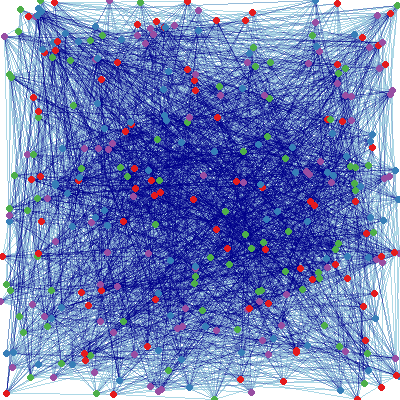
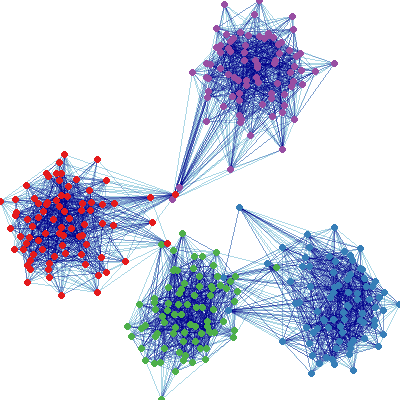
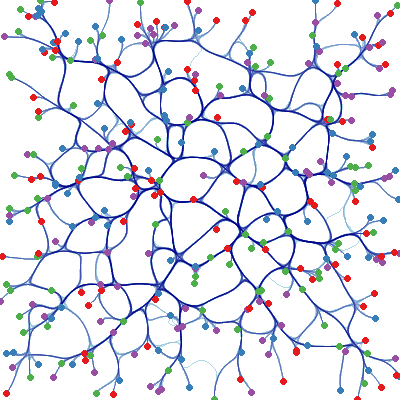
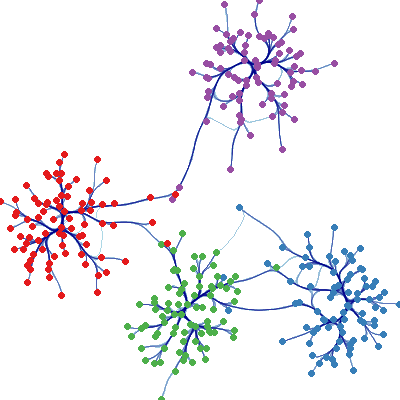

In [26]:
rd = random_layout(     cnodes, cedges)
fd = forceatlas2_layout(cnodes, cedges)

rd_d = graphplot(rd, connect_edges(rd,cedges), "Random layout",          cat="cat")
fd_d = graphplot(fd, connect_edges(fd,cedges), "Force-directed",         cat="cat") 
rd_b = graphplot(rd, hammer_bundle(rd,cedges), "Random layout, bundled", cat="cat")
fd_b = graphplot(fd, hammer_bundle(fd,cedges), "Force-directed, bundled",cat="cat") 

tf.Images(rd_d,fd_d,rd_b,fd_b).cols(2)

As you can see, the highly interconnected subgroups are laid out in separate locations in the plane, mostly non-overlapping, allowing these groups to be detected visually in a way that they aren't in a random layout, with or without bundling.

## Interactive graphs

The above plots all show static images of nodes and edges, with optional category information, but there's no way to see the specific identity of individual nodes.  With small numbers of nodes you can try coloring them to convey identity, but in general the only practical way to reveal identity of nodes or edges is typically interactively, as a user inspects individual items.  Thus interactive plots are often necessary for doing any exploration of real-world graph data.

The simplest way to work with interactive datashaded graphs is to use [HoloViews](http://holoviews.org), which includes specific support for [plotting graphs with and without Datashader](http://holoviews.org/user_guide/Network_Graphs.html):

In [27]:
circle = hv.Graph(edges, label='Bokeh edges').opts(node_size=5)
hnodes = circle.nodes.opts(size=5)
dscirc = (hd.dynspread(hd.datashade(circle))*hnodes).relabel("Datashader edges")

circle + dscirc

:Layout
   .Graph.Bokeh_edges           :Graph   [source,target]
   .DynamicMap.Datashader_edges :DynamicMap   []
      :Overlay
         .RGB.Bokeh_edges :RGB   [x,y]   (R,G,B,A)
         .Nodes.I         :Nodes   [x,y,index]

### Using with NetworkX

In [28]:
def ng(graph,name):
    graph.name = name
    return graph

def nx_layout(graph):
    layout = nx.circular_layout(graph)
    data = [[node]+layout[node].tolist() for node in graph.nodes]

    nodes = pd.DataFrame(data, columns=['id', 'x', 'y'])
    nodes.set_index('id', inplace=True)

    edges = pd.DataFrame(list(graph.edges), columns=['source', 'target'])
    return nodes, edges

def nx_plot(graph, name=""):
    print(graph.name, len(graph.edges))
    nodes, edges = nx_layout(graph)
    
    direct = connect_edges(nodes, edges)
    bundled_bw005 = hammer_bundle(nodes, edges)
    bundled_bw030 = hammer_bundle(nodes, edges, initial_bandwidth=0.30)

    return [graphplot(nodes, direct,         graph.name),
            graphplot(nodes, bundled_bw005, "Bundled bw=0.05"),
            graphplot(nodes, bundled_bw030, "Bundled bw=0.30")]

Complete 1225
Lollipop 1230
Barbell 2453
Ladder 148
Circular Ladder 150
Star 50
Cycle 50


Complete,Bundled bw=0.05,Bundled bw=0.30
Lollipop,Bundled bw=0.05,Bundled bw=0.30
Barbell,Bundled bw=0.05,Bundled bw=0.30
Ladder,Bundled bw=0.05,Bundled bw=0.30
Circular Ladder,Bundled bw=0.05,Bundled bw=0.30
Star,Bundled bw=0.05,Bundled bw=0.30
Cycle,Bundled bw=0.05,Bundled bw=0.30

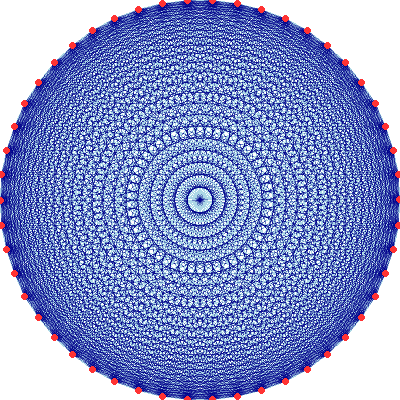
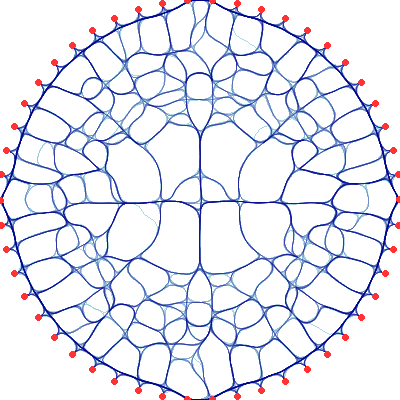
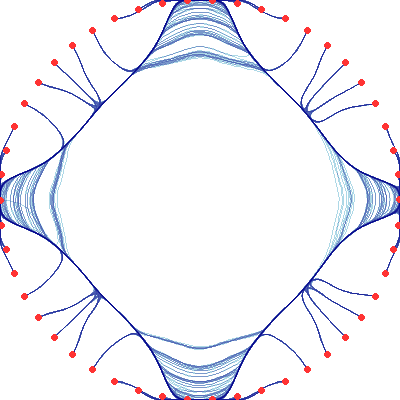
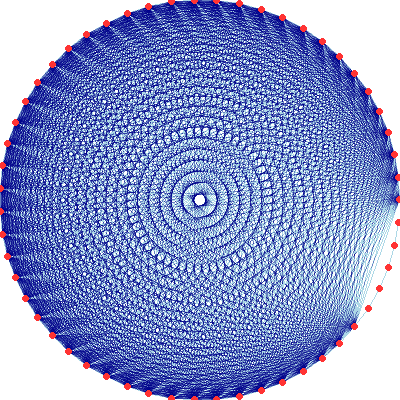
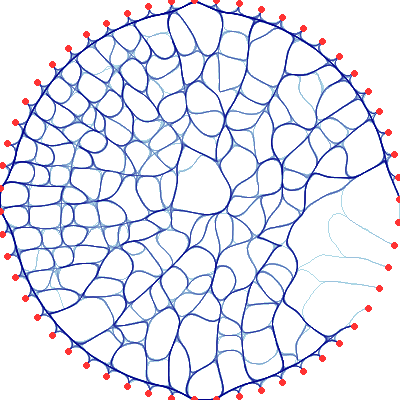
...
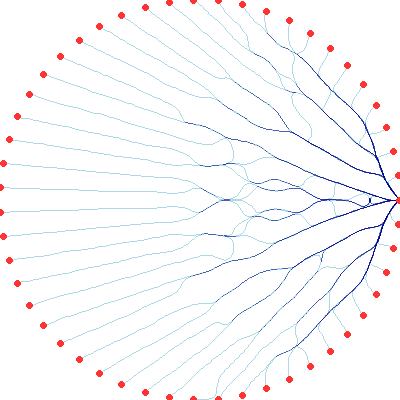
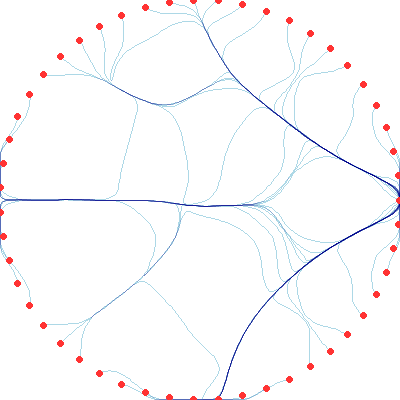
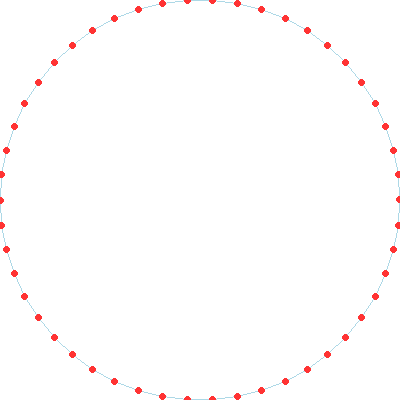
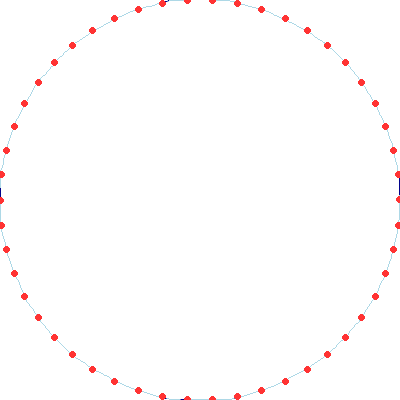
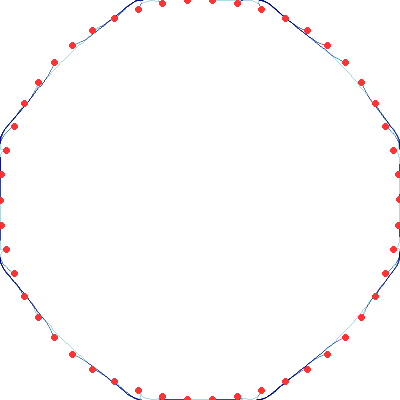

In [29]:
n=50
plots = [nx_plot(g) for g in
           [ng(nx.complete_graph(n),        name="Complete"), 
            ng(nx.lollipop_graph(n, 5),     name="Lollipop"),     
            ng(nx.barbell_graph(n,2),       name="Barbell"),
            ng(nx.ladder_graph(n),          name="Ladder"),   
            ng(nx.circular_ladder_graph(n), name="Circular Ladder"), 
            ng(nx.star_graph(n),            name="Star"),
            ng(nx.cycle_graph(n),           name="Cycle")]]

tf.Images(*chain.from_iterable(plots)).cols(3)

In these plots, you can select the Bokeh "wheel zoom" from the tool palette and then zoom using your scroll wheel or pan by clicking and dragging.  On a static site like a website or anaconda.org the lines in the Datashader plot will be rescaled blockily as you zoom in, but with a live server it will be dynamically re-rendered to show more detailed structure each time. 

You can try clicking and hovering on either plot to see what interactive features are available; in both cases the behavior for nodes should be the same (as the full set of nodes is being overlaid on both plots), while the edges also support interactivity in the pure-Bokeh version.

As you can see, the pure-Bokeh version provides more interactivity, but the datashaded version will let you see the patterns of connectivity better for large graphs.  The datashader version will also work fine for  arbitrarily large graphs that would overwhelm the browser if used with Bokeh directly.  [HoloViews](http://holoviews.org/user_guide/Network_Graphs.html) makes it simple to switch between these two extremes as needed, using full-interactive plots for small datasets and adding whatever interactivity is required (as in the overlaid node plots on the right above) for larger datasets while rendering the full dataset as the main plot using datashader.

## Real-world examples

###  1 - Citeseer Network of Citations  

Based on [this](https://towardsdatascience.com/visualising-graph-data-with-python-igraph-b3cc81a495cf) and [this](https://gist.github.com/Vini2/d13b12b37b01b4001cabf38b1f850d8a#file-visualise_graph_demo-ipynb), with data from [here](http://networkrepository.com/citeseer.php) 

### Using Igraph

#### Build the Graph

In [30]:
import igraph

In [31]:
n_vertices = 3264
# Create graph
g = igraph.Graph()

# Add vertices
g.add_vertices(n_vertices)

edges = []
weights = []

with open("../../Data/csv/citeseer/citeseer.edges", "r") as edges_file:
    line = edges_file.readline()
    while line != "":
        strings = line.rstrip().split(",")
        # Add edge to edge list
        edges.append(((int(strings[0])-1), (int(strings[1])-1)))
        # Add weight to weight list
        weights.append(float(strings[2]))
        line = edges_file.readline()

# Add edges to the graph
g.add_edges(edges)

# Add weights to edges in the graph
g.es['weight'] = weights

#### Visualise the Graph

In [32]:
out_fig_name = "graph.eps"

visual_style = {}
# Define colors used for outdegree visualization
colours = ['#fecc5c', '#a31a1c']
# Set bbox and margin
visual_style["bbox"] = (3000,3000)
visual_style["margin"] = 17
# Set vertex colours
visual_style["vertex_color"] = 'grey'
# Set vertex size
visual_style["vertex_size"] = 20
# Set vertex lable size
visual_style["vertex_label_size"] = 8
# Don't curve the edges
visual_style["edge_curved"] = False
# Set the layout - https://igraph.org/python/doc/tutorial/tutorial.html#layout-algorithms
#my_layout = g.layout_fruchterman_reingold()
my_layout = g.layout("lgl")
visual_style["layout"] = my_layout
# Plot the graph
igraph.plot(g, out_fig_name, **visual_style)

/home/renato/Documents/env_default/lib/python3.10/site-packages/igraph/layout.py:689: RuntimeWarning: LGL layout does not support disconnected graphs yet. at src/layout/large_graph.c:172
  layout = func(*args, **kwds)


#### Visualise the Graph according to Labels

In [33]:
n_classes = 6

bins = [[] for x in range(n_classes)]
with open("../../Data/csv/citeseer/citeseer.node_labels", "r") as labels_file:
    line = labels_file.readline()
    while line != "":
        strings = line.rstrip().split(",")
        vertex_id = int(strings[0])-1
        bin_id = int(strings[1])-1
        bins[bin_id].append(vertex_id)
        line = labels_file.readline()

In [34]:
node_colours = []

for i in range(n_vertices):
    if i in bins[0]:
        node_colours.append("green")
    elif i in bins[1]:
        node_colours.append("yellow")
    elif i in bins[2]:
        node_colours.append("red")
    elif i in bins[3]:
        node_colours.append("blue")
    elif i in bins[4]:
        node_colours.append("orange")
    elif i in bins[5]:
        node_colours.append("pink")
    else:
        node_colours.append("grey")

out_fig_name = "labelled_graph.eps"
g.vs["color"] = node_colours
visual_style = {}
# Define colors used for outdegree visualization
colours = ['#fecc5c', '#a31a1c']
# Set bbox and margin
visual_style["bbox"] = (3000,3000)
visual_style["margin"] = 17
# Set vertex size
visual_style["vertex_size"] = 20
# Set vertex lable size
visual_style["vertex_label_size"] = 8
# Don't curve the edges
visual_style["edge_curved"] = False
# Set the layout
visual_style["layout"] = my_layout
# Plot the graph
igraph.plot(g, out_fig_name, **visual_style)

#### Analyse the Graph

In [35]:
print("Number of vertices:", g.vcount())
print("Number of edges:", g.ecount())
print("Density of the graph:", 2*g.ecount()/(g.vcount()*(g.vcount()-1)))

Number of vertices: 3264
Number of edges: 4536
Density of the graph: 0.000851796434172811


In [36]:
degrees = []
total = 0

for n in range(n_vertices):
    neighbours = g.neighbors(n, mode='ALL')
    total += len(neighbours)
    degrees.append(len(neighbours))
    
print("Average degree:", total/n_vertices)
print("Maximum degree:", max(degrees))
print("Vertex ID with the maximum degree:", degrees.index(max(degrees)))

Average degree: 2.7794117647058822
Maximum degree: 99
Vertex ID with the maximum degree: 2906


Degree having the maximum number of vertices: 1
Number of vertices having the most abundant degree: 1321


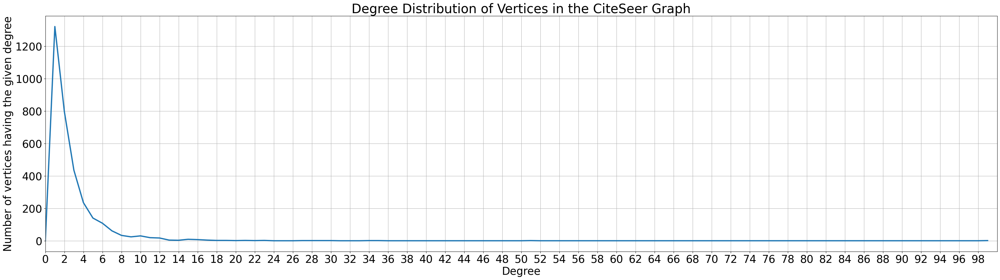

<Figure size 640x480 with 0 Axes>

In [37]:
import matplotlib.pyplot as plt
import numpy as np
plt.rcParams.update({'font.size': 25})

x = [x for x in range(max(degrees)+1)]
degree_counts = [0 for x in range(100)]

for i in degrees:
    degree_counts[i] += 1

print("Degree having the maximum number of vertices:", degree_counts.index(max(degree_counts)))
print("Number of vertices having the most abundant degree:", max(degree_counts))

plt.figure(figsize=(40,10))
plt.plot(x, degree_counts, linewidth=3.0)
plt.ylabel('Number of vertices having the given degree')
plt.xlabel('Degree')
plt.title('Degree Distribution of Vertices in the CiteSeer Graph')

plt.xlim(0,100)
plt.xticks(np.arange(min(x), max(x)+1, 2.0))
plt.grid(True)
plt.savefig('degree_distribution.png', bbox_inches='tight')
plt.show()
plt.draw()

In [38]:
# Source: https://stackoverflow.com/questions/34219481/python-igraph-finding-number-of-triangles-for-each-vertex

cliques = g.cliques(min=3, max=3)
triangle_count = [0] * g.vcount()
for i, j, k in cliques:
    triangle_count[i] += 1
    triangle_count[j] += 1
    triangle_count[k] += 1

print("Average number of triangles:", sum(triangle_count)/g.vcount())
print("Maximum number of triangles:", max(triangle_count))
print("Vertex ID with the maximum number of triangles:", triangle_count.index(max(triangle_count)))

Average number of triangles: 1.0716911764705883
Maximum number of triangles: 85
Vertex ID with the maximum number of triangles: 2906


In [39]:
print("Diameter of the graph:", g.diameter())

Diameter of the graph: 28


In [40]:
# Source: https://snipplr.com/view/9914

def assortativity(graph, degrees=None):
    if degrees is None: degrees = graph.degree()
    degrees_sq = [deg**2 for deg in degrees]
 
    m = float(graph.ecount())
    num1, num2, den1 = 0, 0, 0
    for source, target in graph.get_edgelist():
        num1 += degrees[source] * degrees[target]
        num2 += degrees[source] + degrees[target]
        den1 += degrees_sq[source] + degrees_sq[target]
 
    num1 /= m
    den1 /= 2*m
    num2 = (num2 / (2*m)) ** 2
 
    return (num1 - num2) / (den1 - num2)

print("Assortativity of the graph:", assortativity(g))

Assortativity of the graph: 0.04806382149471062


###  2 - Philosophers Influences Chain  

Based on [this](https://www.analyticsvidhya.com/blog/2018/09/introduction-graph-theory-applications-python/), with examples inspired in [this](http://www.coppelia.io/2012/06/graphing-the-history-of-philosophy/) and [this](http://brendangriffen.com/blog/gow-influential-thinkers) experiments. Information crawled from [DBpedia](https://wiki.dbpedia.org/).

[SPARQL Tutorial](https://www.wikidata.org/wiki/Wikidata:SPARQL_tutorial)  
[DBPedia Endpoint](https://dbpedia.org/sparql)  

The internet is big — very big. One such way to investigate all of this free online content is through graphs.  
To start, let’s look at how people influenced each other throughout history as entered by the authors of Wikipedia.  
If you search for a notable figure you might find the following on the sidebar:  

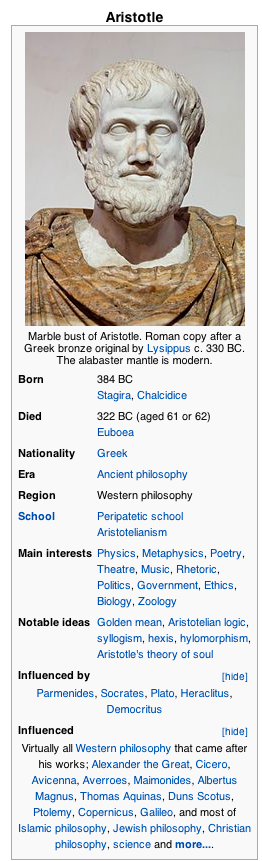

In [41]:
Image(filename='../../Data/figs/aristotle-wikipedia.png')

Here we see a list of people that have been influenced by Aristotle. We also see who Aristotle himself was influenced by. At the moment, these are just names, but this provides a way we can connect Aristotle to other people throughout history. If only we had a way to collect this data using a simple database-like query.

Our task is to answer the questions:  

 1) What are the top 10 personalities in terms of power to generate influences?  
 2) What are the 10 personalities that were influenced by the most number of people?  
 3) What are the 5 major "clusters" of personalities who were influenced by a similar group of the same influencers?   
(Consider a cluster as the group of personalities who were influenced by the same Y influencers, Y being an arbitrary number. Start with Y = 2 and grow until there is no 2 people influenced by all of them.  

 4) What are the 5 major influences chains (eg, A -> B -> C -> ...)?  
 5) What are the countries that generated the greatest influential?  

And, at the end, create a graphical representation of the graph  

Collect Data

First we require a database-like, indexed version of Wikipedia to collect our data. [DBpedia](https://wiki.dbpedia.org/) is one such venture which has been created as part of the Wikipedia project. This structured content is then made available to the public at no cost. DBpedia allows you to query relationships and properties associated with Wikipedia resources, including links to other related datasets. The first graph will connect people via their known influences. The snippet of code entered into the [SPARQL Explorer](http://dbpedia.org/snorql/) looks something like this:

In [42]:
sparql_query = '''
SELECT * WHERE
{?p a <http://dbpedia.org/ontology/Person>.
?p <http://dbpedia.org/ontology/influenced> ?influenced.
?influenced a <http://dbpedia.org/ontology/Person>. }
'''

If you'd want to do the same analysis, as an example, for programming languages, the query would be:

In [43]:
sparql_query2 = '''
SELECT *
WHERE { ?p a <http://dbpedia.org/ontology/ProgrammingLanguage> .
?p <http://dbpedia.org/ontology/influenced> ?influenced . }
'''

We are using Python SPARQLWrapper library to make a direct query and use the results:

In [44]:
from SPARQLWrapper import SPARQLWrapper, JSON

In [45]:
sparql = SPARQLWrapper("http://dbpedia.org/sparql")
sparql.setQuery(sparql_query)
sparql.setReturnFormat(JSON)
results = sparql.query().convert()

In [46]:
len(results['results']['bindings'])

7787

In [47]:
results['results']['bindings'][0]

{'p': {'type': 'uri', 'value': 'http://dbpedia.org/resource/Alexandre_Kojève'},
 'influenced': {'type': 'uri',
  'value': 'http://dbpedia.org/resource/Allan_Bloom'}}

In [48]:
for result in results['results']['bindings'][90:100]:
    print(result['influenced']['value'].strip('http://dbpedia.org/resource/').replace('_',' '), 
          ' --> ', result['p']['value'].strip('http://dbpedia.org/resource/').replace('_',' '))

Alexander Blok  -->  Vladimir Solovyov (philosopher)
Alexander Hamilton  -->  David Hum
Alexander Neham  -->  Walter Kaufmann (philosopher)
Alexander Piatigorsky  -->  David B. Zilberman
Alexandre Kojèv  -->  Vladimir Solovyov (philosopher)
Alexandre Kojèv  -->  Alexandre Koyré
Alfred Freddy K  -->  Alfred K
Alfred Marshall  -->  Vilfredo P
Alfred Russel Wall  -->  Alexander von Humbol
Alice von Hildebran  -->  Dietrich von Hildebran


In [51]:
with open("../../Data/csv/influences2.csv", mode= 'w', encoding="utf-8") as f:
    f.write('"influences";"influenced"\n')
    for result in results['results']['bindings']:
        f.write('"{}";"{}"\n'.format(result['influenced']['value'].strip('http://dbpedia.org/resource/').replace('_',' '),
                                     result['p']['value'].strip('http://dbpedia.org/resource/').replace('_',' ')))

But we will work with a cleaner version of the file, because some of the URLs present incomplete names and we would need to query each individual page to grab them.

#### Loading the dataset

In [52]:
csvfile = codecs.open("../../Data/csv/influences.csv", encoding="utf-8").readlines()

In [53]:
len(csvfile)

5009

In [54]:
csvfile[0:5]

['"Influences","Influenced"\n',
 '"Ferdinand de Saussure","Jacques Lacan"\n',
 '"Georg Wilhelm Friedrich Hegel","Jacques Lacan"\n',
 '"Sigmund Freud","Jacques Lacan "\n',
 '"Benjamin Tucker","Robert Anton Wilson "\n']

#### Doing some cleaning  

In [55]:
lines = [line.strip() for line in csvfile]
lines2 = []
for line in lines:
    line = line.replace('",','";')
    line = line.replace('"','').strip()
    lines2.append(line)
for line in lines2[0:6]:
    print(line)

Influences;Influenced
Ferdinand de Saussure;Jacques Lacan
Georg Wilhelm Friedrich Hegel;Jacques Lacan
Sigmund Freud;Jacques Lacan
Benjamin Tucker;Robert Anton Wilson
Brian O'Nolan;Robert Anton Wilson


In [56]:
influences = np.array([(line.split(';')[0],line.split(';')[1]) for line in lines2])
print('Dimensions: {}'.format(influences.shape))
influences[:10]

Dimensions: (5009, 2)


array([['Influences', 'Influenced'],
       ['Ferdinand de Saussure', 'Jacques Lacan'],
       ['Georg Wilhelm Friedrich Hegel', 'Jacques Lacan'],
       ['Sigmund Freud', 'Jacques Lacan'],
       ['Benjamin Tucker', 'Robert Anton Wilson'],
       ["Brian O'Nolan", 'Robert Anton Wilson'],
       ['Terence McKenna', 'Robert Anton Wilson'],
       ['Colin Wilson', 'Robert Anton Wilson'],
       ['Robert W. Chambers', 'Robert Anton Wilson'],
       ['Aristotle', 'Alexander the Great']], dtype='<U52')

In [57]:
pd_influences = pd.DataFrame(influences[1:,:], columns = influences[0])
pd_influences.head(10)

,Influences,Influenced
0,Ferdinand de Saussure,Jacques Lacan
1,Georg Wilhelm Friedrich Hegel,Jacques Lacan
2,Sigmund Freud,Jacques Lacan
3,Benjamin Tucker,Robert Anton Wilson
4,Brian O'Nolan,Robert Anton Wilson
5,Terence McKenna,Robert Anton Wilson
6,Colin Wilson,Robert Anton Wilson
7,Robert W. Chambers,Robert Anton Wilson
8,Aristotle,Alexander the Great
9,Charles Grafton Page,Alexander Graham Bell


In [58]:
#nodes = influences[1:,0]
#edges = influences[1:,1]
G = nx.DiGraph()
G.add_edges_from(influences[1:], weight = 1)

print('Number of nodes is: {}'.format(G.number_of_nodes()))
print('Number of edges is: {}'.format(G.number_of_edges()))
print()
#print(G.edges())

Number of nodes is: 3589
Number of edges is: 5008



In [59]:
list(G.neighbors('Sigmund Freud'))

['Jacques Lacan',
 'Viktor Frankl',
 'Fritz Perls',
 'Wilhelm Reich',
 'John Bowlby',
 'Carl Jung',
 'Otto Rank',
 'Anna Freud',
 'Eugen Bleuler']

In [60]:
list(G.successors('Sigmund Freud'))

['Jacques Lacan',
 'Viktor Frankl',
 'Fritz Perls',
 'Wilhelm Reich',
 'John Bowlby',
 'Carl Jung',
 'Otto Rank',
 'Anna Freud',
 'Eugen Bleuler']

In [61]:
list(G.predecessors('Sigmund Freud'))

['Friedrich Nietzsche',
 'Johann Wolfgang von Goethe',
 'Franz Brentano',
 'Josef Breuer',
 'Ernst Wilhelm von Brücke',
 'Arthur Schopenhauer',
 'Sándor Ferenczi',
 'Karl Robert Eduard von Hartmann',
 'Baruch Spinoza',
 'Jens Peter Jacobsen']

In [62]:
list(G.adjacency())[0:2]

[('Ferdinand de Saussure',
  {'Jacques Lacan': {'weight': 1},
   'Jacques Derrida': {'weight': 1},
   'Louis Althusser': {'weight': 1},
   'Claude Lévi-Strauss': {'weight': 1},
   'Noam Chomsky': {'weight': 1},
   'Michel Foucault': {'weight': 1},
   'Roland Barthes': {'weight': 1},
   'Ernesto Laclau': {'weight': 1}}),
 ('Jacques Lacan', {'Louis Althusser': {'weight': 1}})]

1) What are the top 10 personalities in terms of power to generate influences?  

In [63]:
#most_influencers = Counter(influences[1:,0]).most_common(10)
most_influencers = Counter(dict(G.out_degree())).most_common(10)
df_influencers = pd.DataFrame(most_influencers, columns = ['Influencer', '#influenced'] )
df_influencers

,Influencer,#influenced
0,Georg Wilhelm Friedrich Hegel,44
1,Arthur Schopenhauer,42
2,Friedrich Nietzsche,33
3,William S. Burroughs,30
4,Immanuel Kant,30
5,Karl Marx,30
6,Baruch Spinoza,29
7,G. K. Chesterton,29
8,Samuel Beckett,28
9,Franz Kafka,27


Text(0.5, 1.0, 'Most influents')

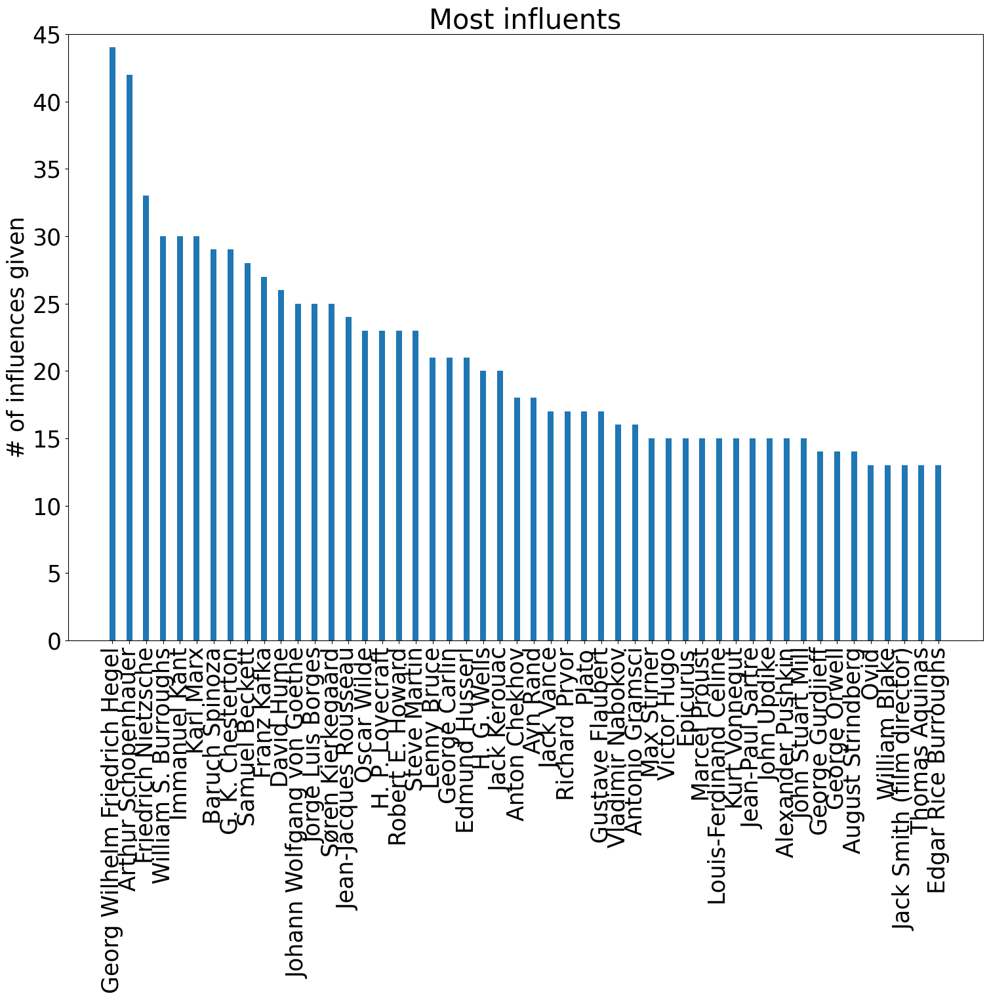

In [64]:
x = np.arange(len(Counter(influences[1:,0]).most_common(50)))
y = list(zip(*Counter(influences[1:,0]).most_common(50)))[1]
labels = list(zip(*Counter(influences[1:,0]).most_common(50)))[0]
y2max = max(y) + 1

plt.figure(figsize=(18,12), dpi=100)
plt.bar(x, y, width=0.35)
plt.xticks(x, labels)
plt.ylim(0, y2max)
plt.xticks(rotation=90)
plt.ylabel('# of influences given')
plt.title('Most influents')

Calculating the Pagerank

In [65]:
pr = nx.pagerank(G.reverse())
pr_sorted = sorted(pr.items(), key=operator.itemgetter(1), reverse=True)
pr_sorted[0:20]

[('Georg Wilhelm Friedrich Hegel', 0.006456112765203312),
 ('Parmenides', 0.0062306846639323555),
 ('Arthur Schopenhauer', 0.005640334066569838),
 ('Democritus', 0.00519442393431106),
 ('Johann Wolfgang von Goethe', 0.004974543368379513),
 ('Heraclitus', 0.004892530720708624),
 ('Plato', 0.004683206868285835),
 ('Pythagoras', 0.004500821556126089),
 ('Francisco Suárez', 0.004500788454584592),
 ('Jean-Jacques Rousseau', 0.004466297058463299),
 ('Leucippus', 0.004448860874430326),
 ('Aristotle', 0.004432430646626085),
 ('Baruch Spinoza', 0.004360840037319772),
 ('René Descartes', 0.004095405840038507),
 ('Pyrrho', 0.004025641995048535),
 ('Hugo Grotius', 0.003948885416504512),
 ('Plotinus', 0.0039052401306109525),
 ('David Hume', 0.00379952007395603),
 ('Immanuel Kant', 0.0037181976601677706),
 ('Maimonides', 0.0036433574233027265)]

In [66]:
bb = nx.betweenness_centrality(G)
bb_sorted = sorted(bb.items(), key=operator.itemgetter(1), reverse=True)
bb_sorted[0:20]

[('Friedrich Nietzsche', 0.0015763617714143737),
 ('Jean-Paul Sartre', 0.0014603027778478776),
 ('Immanuel Kant', 0.0014317506068786587),
 ('Georg Wilhelm Friedrich Hegel', 0.0014195034546051685),
 ('William S. Burroughs', 0.0013268875593367428),
 ('Arthur Schopenhauer', 0.0012259133027170675),
 ('Johann Wolfgang von Goethe', 0.0010328277643159457),
 ('Samuel Beckett', 0.0010078169447079535),
 ('Karl Marx', 0.0009474067259988782),
 ('H. P. Lovecraft', 0.0009053435436008165),
 ('Franz Kafka', 0.0007937849100767014),
 ('André Gide', 0.0007711192962060072),
 ('David Hume', 0.0007592098788326789),
 ('Gottfried Leibniz', 0.0007144025161416467),
 ('Albert Camus', 0.0006676373692248017),
 ('Oscar Wilde', 0.0006509056387014187),
 ('Baruch Spinoza', 0.0006220262243874386),
 ('George Orwell', 0.0005961877337707979),
 ('Jorge Luis Borges', 0.0005670518434765209),
 ('Søren Kierkegaard', 0.0005467987530208062)]

In [67]:
nx.set_node_attributes(G, bb, 'betweenness')
nx.set_node_attributes(G, pr, 'pagerank')

print(G.nodes['Jorge Luis Borges'])
print(G.nodes['David Hume']['betweenness'])
print(G.nodes['Karl Marx']['pagerank'])

{'betweenness': 0.0005670518434765209, 'pagerank': 0.0015717708610777554}
0.0007592098788326789
0.0028635345594124175


 2) What are the 10 personalities that were influenced by the most number of people? 

In [68]:
#most_influenced = Counter(influences[1:,1]).most_common(10)
most_influenced = Counter(dict(G.in_degree())).most_common(10)
df_influenced = pd.DataFrame(most_influenced, columns = ['Influenced', '#influences'] )
df_influenced

,Influenced,#influences
0,Friedrich Nietzsche,21
1,Martin Heidegger,20
2,Michel Foucault,19
3,Jean-Paul Sartre,18
4,Stephen King,17
5,Gilles Deleuze,17
6,Georg Wilhelm Friedrich Hegel,16
7,Immanuel Kant,16
8,Bertrand Russell,16
9,Jorge Luis Borges,15


Text(0.5, 1.0, 'Influenced by most')

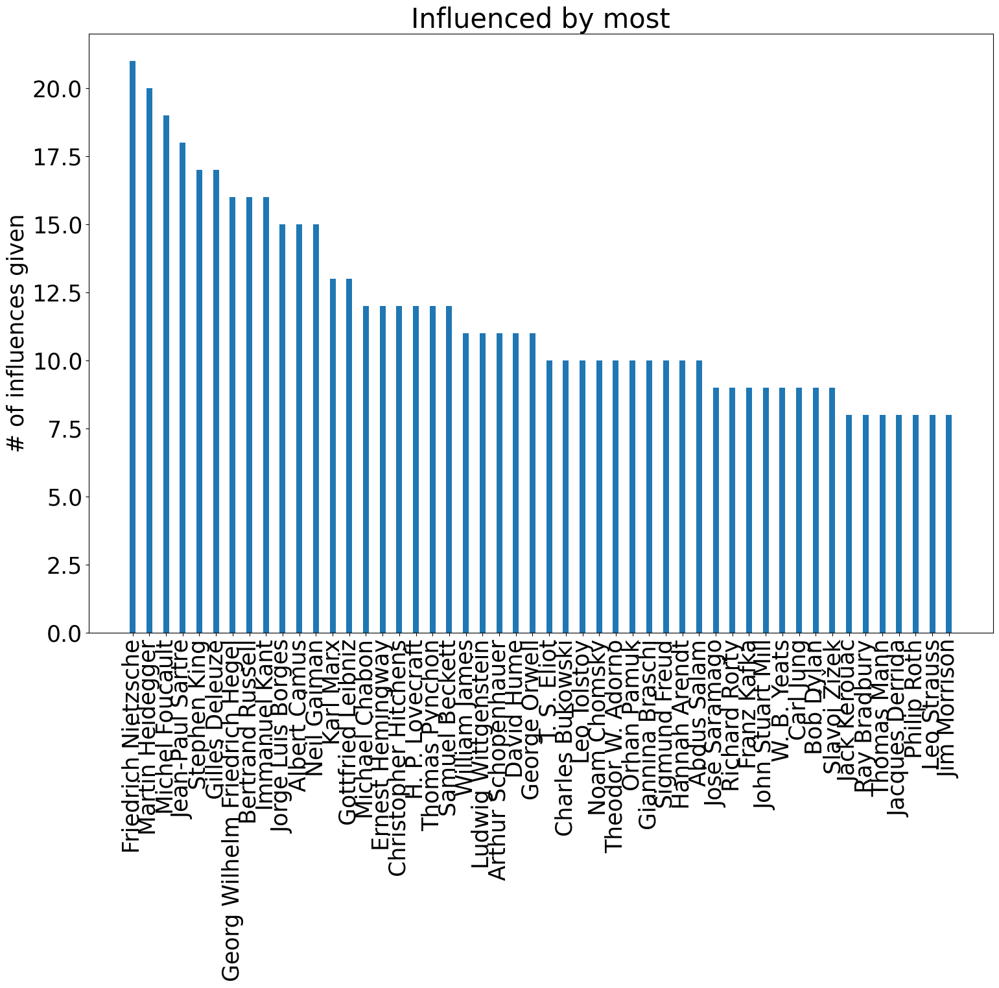

In [69]:
x = np.arange(len(Counter(influences[1:,1]).most_common(50)))
y = list(zip(*Counter(influences[1:,1]).most_common(50)))[1]
labels = list(zip(*Counter(influences[1:,1]).most_common(50)))[0]
y2max = max(y) + 1

plt.figure(figsize=(18,12), dpi=100)
plt.bar(x, y, width=0.35)
plt.xticks(x, labels)
plt.ylim(0, y2max)
plt.xticks(rotation=90)
plt.ylabel('# of influences given')
plt.title('Influenced by most')

3) What are the 5 major "clusters" of personalities who were influenced by a similar group of the same influencers?   

(Consider a cluster as the group of personalities who were influenced by the same $\tau$ influencers, $\tau$ being an arbitrary number. Start with $\tau$ = 2 and grow until there is no 2 people influenced by all of them.  

4) What are the 5 major influences chains (eg, A -> B -> C -> ...)?

In [70]:
#Shortest path between all nodes
crescent_shortest_paths = nx.all_pairs_shortest_path(G)

paths = []
for key, dictvalue in crescent_shortest_paths:
    for key, value in dictvalue.items():
        paths.append(value)

In [71]:
path_sizes = [len(p) for p in paths]

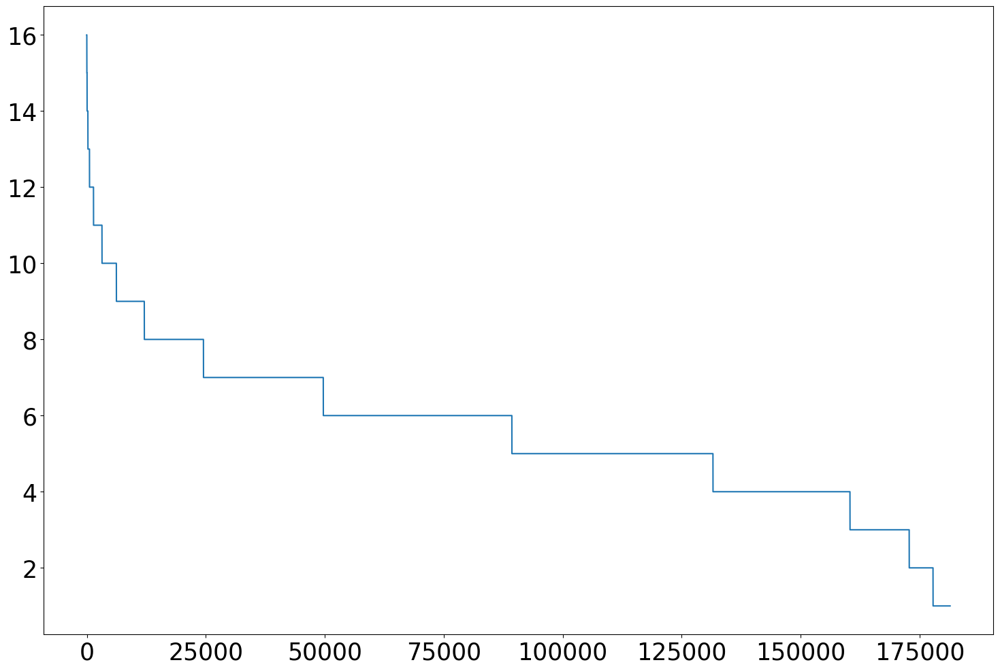

In [72]:
plt.figure(figsize=(18,12), dpi=100)
plt.plot(sorted(path_sizes, reverse=True))

In [73]:
crescent_shortest_paths = nx.all_pairs_shortest_path(G)
longest_paths = []
for key, dictvalue in crescent_shortest_paths:
    for key, value in dictvalue.items():
        if(len(value) > 14):
            longest_paths.append(value)

Path 1: ['Crates of Thebes', 'Zeno of Citium', 'Posidonius', 'Cicero', 'Pierre-Joseph Proudhon', 'Peter Kropotkin', 'Oscar Wilde', 'André Gide', "Brian O'Nolan", 'Spike Milligan', 'Monty Python', 'George Carlin', 'Sam Kinison', 'Larry the Cable Guy', 'Robert Kelly (comedian)']

Path 2: ['Euclid of Megara', 'Stilpo', 'Zeno of Citium', 'Posidonius', 'Cicero', 'Pierre-Joseph Proudhon', 'Peter Kropotkin', 'Oscar Wilde', 'André Gide', "Brian O'Nolan", 'Spike Milligan', 'Monty Python', 'George Carlin', 'Stephen Colbert', 'Rob Corddry']

Path 3: ['Euclid of Megara', 'Stilpo', 'Zeno of Citium', 'Posidonius', 'Cicero', 'Pierre-Joseph Proudhon', 'Peter Kropotkin', 'Oscar Wilde', 'André Gide', "Brian O'Nolan", 'Spike Milligan', 'Monty Python', 'George Carlin', 'Stephen Colbert', 'Aasif Mandvi']

Path 4: ['Euclid of Megara', 'Stilpo', 'Zeno of Citium', 'Posidonius', 'Cicero', 'Pierre-Joseph Proudhon', 'Peter Kropotkin', 'Oscar Wilde', 'André Gide', "Brian O'Nolan", 'Spike Milligan', 'Monty Python'

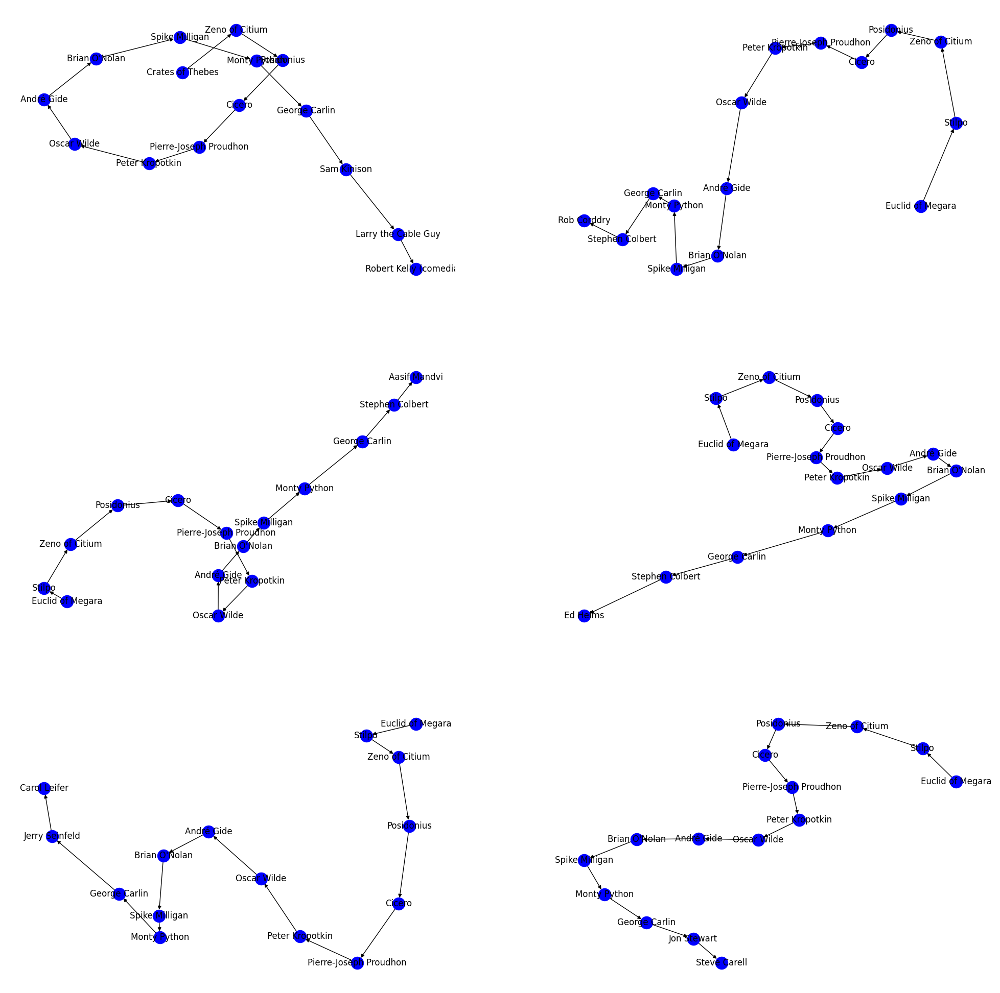

In [74]:
fig = plt.figure(figsize= (25, 25) )
index = 1

for i in longest_paths:
    print("Path " + str(index) + ": " + str(i) + "\n")
    graph = nx.DiGraph()
    nx.add_path(graph, i)
    ax = fig.add_subplot(3,2, index)
    pos = nx.drawing.fruchterman_reingold_layout(graph)
    nx.draw(graph, pos, node_color='blue', with_labels=True) 
    index += 1
    if index > 6:
        break

5) What are the countries that generated the greatest influential? 

In [75]:
#Scraping data from Wikipedia
nationality = []
main_interests = []

for i in range(0,10):
        name = df_influencers.Influencer[i].replace(' ','_')
        url= 'http://en.wikipedia.org/wiki/' + name
        source = urllib.request.urlopen(url).read()
        soup = BeautifulSoup(source, "lxml")
        information_with_tags = soup.findAll('tr')
        information = [t.getText() for t in information_with_tags]
        born = [inf for inf in information if 'Born' in inf]
        if born:
            nationality.append(born)
        else: 
            nationality.append('Nationality not found')

In [76]:
for i in range(0,10):
    print('{}\t\t was born {}'.format(df_influencers.Influencer[i], nationality[i]))

Georg Wilhelm Friedrich Hegel		 was born ['BornGeorg Wilhelm Friedrich Hegel27 August 1770Stuttgart, Duchy of Württemberg']
Arthur Schopenhauer		 was born ['Born(1788-02-22)22 February 1788Danzig (Gdańsk), Crown of the Kingdom of Poland, Polish–Lithuanian Commonwealth']
Friedrich Nietzsche		 was born ['BornFriedrich Wilhelm Nietzsche(1844-10-15)15 October 1844Röcken, Saxony, Prussia, German Confederation']
William S. Burroughs		 was born ['BornWilliam Seward Burroughs II(1914-02-05)February 5, 1914St. Louis, Missouri, U.S.']
Immanuel Kant		 was born ['Born(1724-04-22)22 April 1724Königsberg, Kingdom of Prussia(present-day Kaliningrad, Russia)']
Karl Marx		 was born ['BornKarl Heinrich Marx(1818-05-05)5 May 1818Trier, Prussia, German Confederation']
Baruch Spinoza		 was born ['BornBento de Espinosa [1](1632-11-24)24 November 1632Amsterdam, Dutch Republic']
G. K. Chesterton		 was born ['Born(1874-05-29)29 May 1874Kensington, London, England']
Samuel Beckett		 was born ['BornSamuel Barcla

7) Create a graphical representation of the graph 

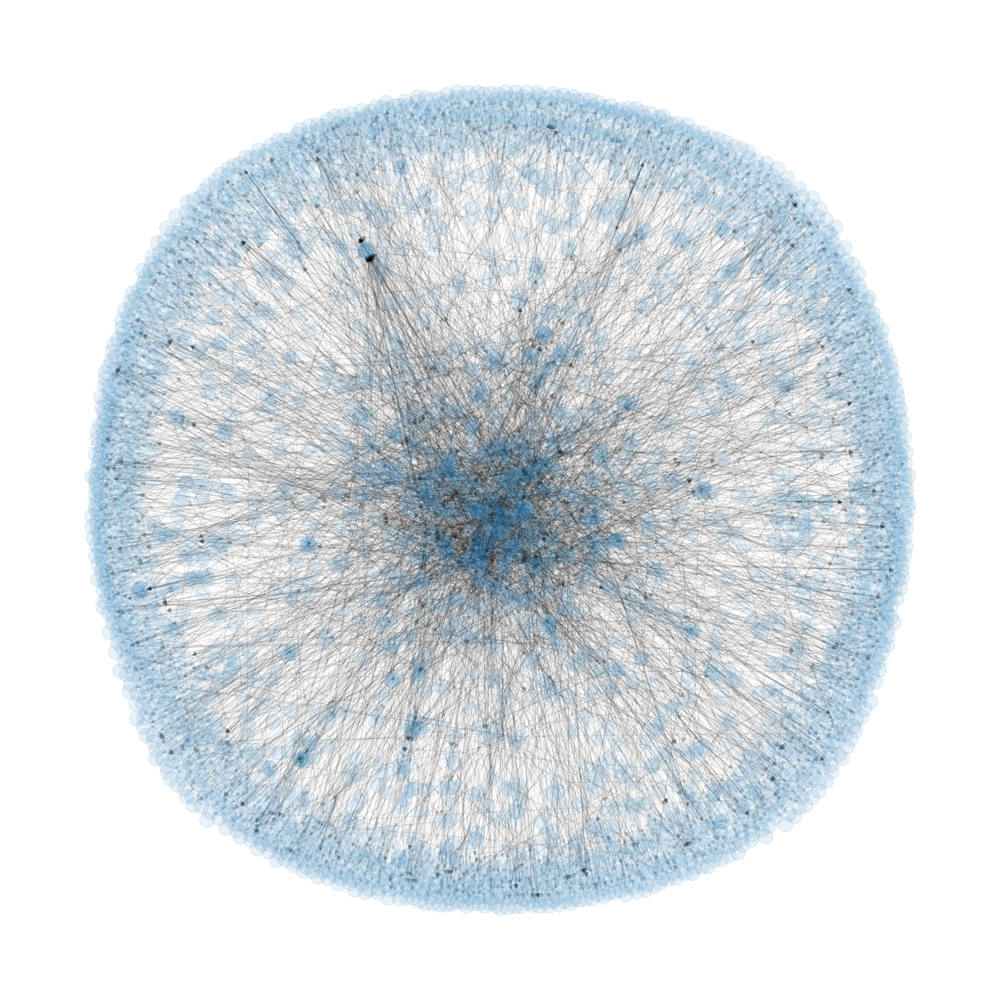

In [77]:
plt.figure(figsize=(16,16))
nx.draw(G, 
        #with_labels = False, 
        #font_size = False, 
        #node_size = False, 
        #node_color = 'r', 
        #arrows = False, 
        alpha = 0.1)

In [78]:
print("Nodes on graph: " + str(G.number_of_nodes()))
print("Connected components: " + str(nx.number_weakly_connected_components(G)))

Nodes on graph: 3589
Connected components: 414


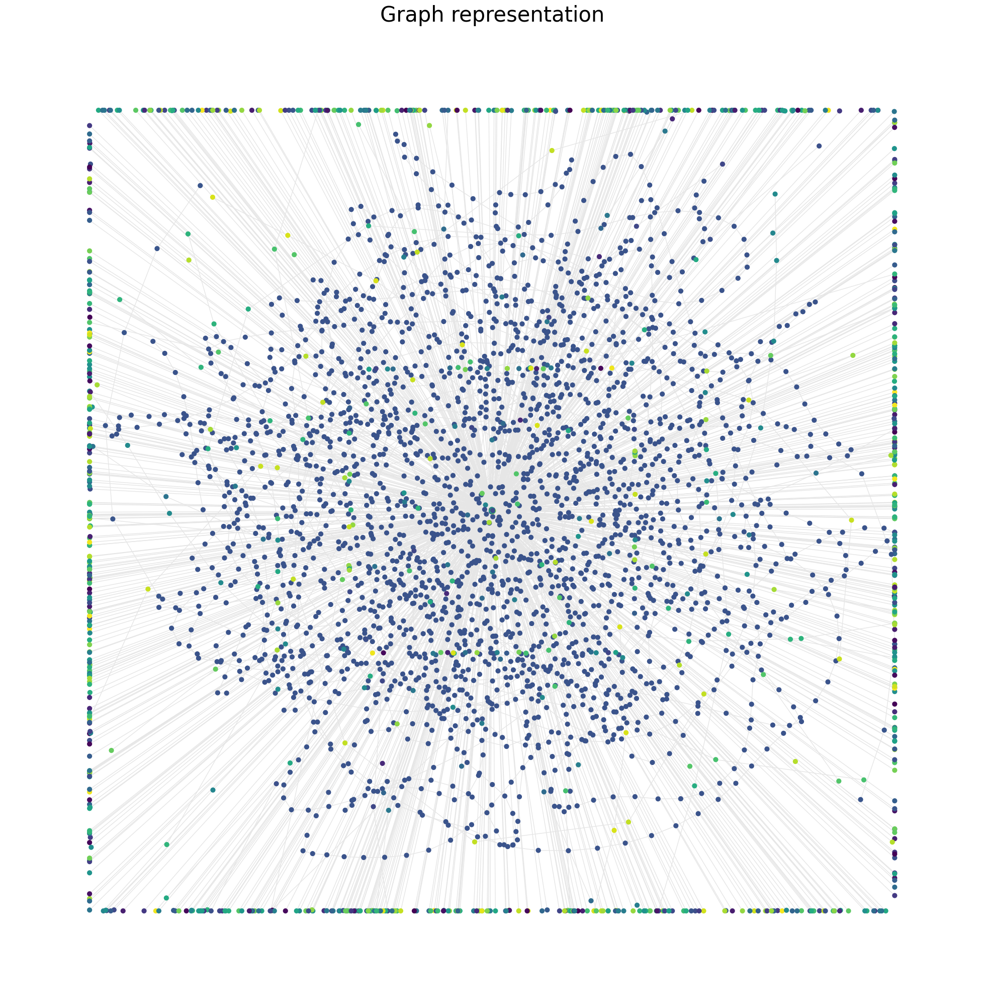

In [79]:
fig = plt.figure(figsize=(25,25))

G2 = nx.algorithms.components.weakly_connected_components(G)
for g in G2:
    c = [random.random()] * len(g) # random color...
    #print(g)
    plt.title('Graph representation')
    nx.draw_spring(nx.path_graph(g), 
                   node_size=40, 
                   node_color=c, 
                   edge_color='#E6E6E6', 
                   vmin=0.0, 
                   vmax=1.0, 
                   with_labels=False, 
                   edge_cmap=plt.cm.gray )

Exporting to Gephi  
https://gephi.org/users/supported-graph-formats/  